In [195]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import confusion_matrix
from PIL import Image
import math
import seaborn as sns
import numpy as np
import os
import cv2
import shutil
import pandas as pd
import random
import time

In [7]:
# silence warnings
import warnings
warnings.filterwarnings('ignore')

In [8]:
# setup for multiple outputs from single cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

The goal of this project is to construct an image classification system using a PyTorch neural network to classify nine common mushroom species. Image classification trainng data sets were extracted from video clips. Nine species of mushrooms were selected for their unique appearances.

THE NINE MUSHROOM SPECIES:



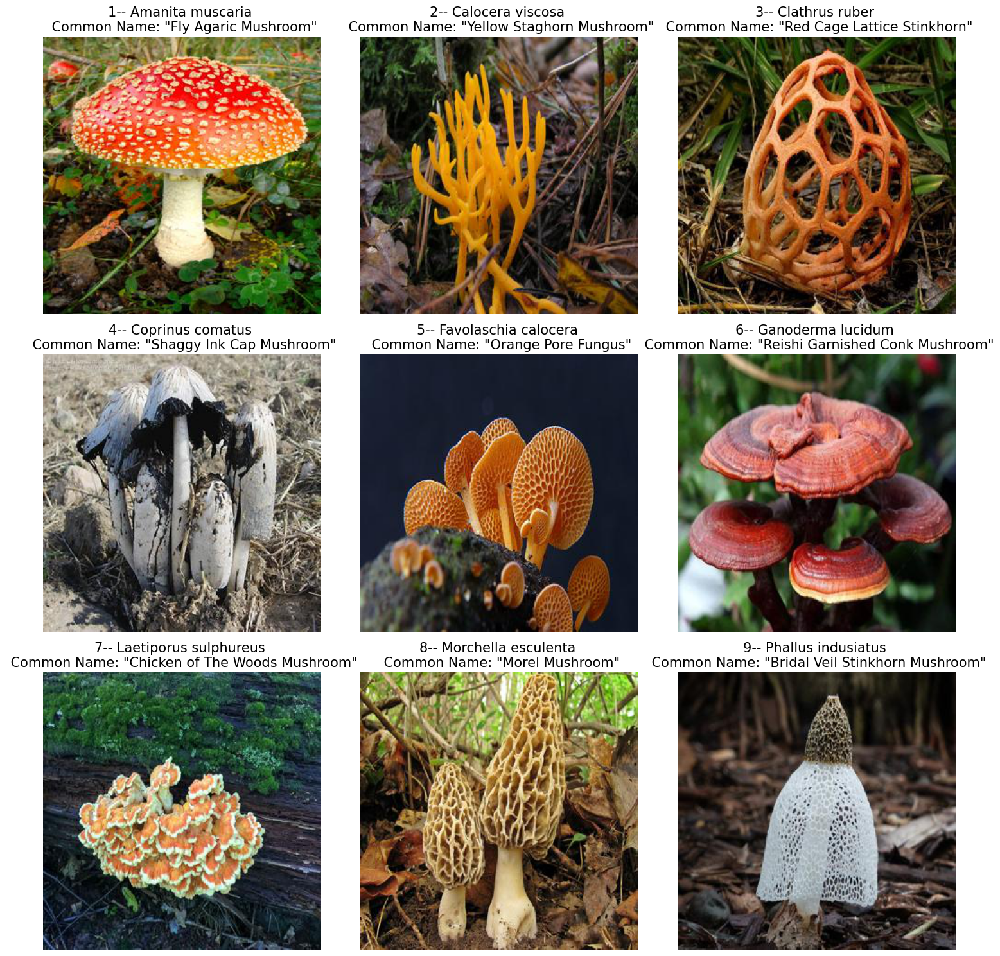

In [207]:
# Display the nine mushroom species
# This script's ("PyTorch_Mushroom_Image_Classification.ipynb") directory to provide 
#   relative location of folder ('Pics') holding pictures
# Adjust this line to reflect any new location 
location_of_this_ipynb_file = '/media/ijmg/SSD_FOUR_TB/ACADEMICS_101/MY_PROJECTS/ADDED_PROJECTS/Fungi/'

# Paths to images (in relative folder 'Pics') and their associated labels
path_to_amanita_muscaria_pic = os.path.join(location_of_this_ipynb_file, 'Pics/amanita_muscaria.jpeg')
path_to_calocera_viscosa_pic = os.path.join(location_of_this_ipynb_file, 'Pics/calocera_viscosa.jpeg')
path_to_clathrus_ruber_pic = os.path.join(location_of_this_ipynb_file, 'Pics/clathrus_ruber.jpeg')
path_to_coprinus_comatus_pic = os.path.join(location_of_this_ipynb_file, 'Pics/coprinus_comatus.jpeg')
path_to_favolaschia_calocera_pic = os.path.join(location_of_this_ipynb_file, 'Pics/favolaschia_calocera.jpeg')
path_to_ganoderma_lucidum_pic = os.path.join(location_of_this_ipynb_file, 'Pics/ganoderma_lucidum.jpeg')
path_to_laetiporus_sulphureus_pic = os.path.join(location_of_this_ipynb_file, 'Pics/laetiporus_sulphureus.jpeg')
path_to_morchella_esculenta_pic = os.path.join(location_of_this_ipynb_file, 'Pics/morchella_esculenta.jpeg')
path_to_phallus_indusiatus_pic = os.path.join(location_of_this_ipynb_file, 'Pics/phallus_indusiatus.jpeg')


image_paths = [path_to_amanita_muscaria_pic, path_to_calocera_viscosa_pic, 
               path_to_clathrus_ruber_pic, path_to_coprinus_comatus_pic,
               path_to_favolaschia_calocera_pic, path_to_ganoderma_lucidum_pic,              
               path_to_laetiporus_sulphureus_pic, path_to_morchella_esculenta_pic,
               path_to_phallus_indusiatus_pic
              ]


labels = ['1-- Amanita muscaria \n Common Name: "Fly Agaric Mushroom"', 
          '2-- Calocera viscosa \n Common Name: "Yellow Staghorn Mushroom"', 
          '3-- Clathrus ruber \n Common Name: "Red Cage Lattice Stinkhorn"', 
          '4-- Coprinus comatus \n Common Name: "Shaggy Ink Cap Mushroom"',
          '5-- Favolaschia calocera \n Common Name: "Orange Pore Fungus"', 
          '6-- Ganoderma lucidum \n Common Name: "Reishi Garnished Conk Mushroom"', 
          '7-- Laetiporus sulphureus \n Common Name: "Chicken of The Woods Mushroom"',         
          '8-- Morchella esculenta \n Common Name: "Morel Mushroom"', 
          '9-- Phallus indusiatus \n Common Name: "Bridal Veil Stinkhorn Mushroom"'         
         ]

# Number of images to display in the grid
num_images = len(image_paths)

# Show the plot
print('THE NINE MUSHROOM SPECIES:\n')
# Create a figure and axes
plt.figure(figsize=(15, 15))

for i in range(0, num_images):

    plt.subplot(3, 3, i + 1)
    # Load image using PIL
    image_pil = Image.open(image_paths[i])
    # Convert PIL image to NumPy array
    image_np = np.array(image_pil)
    # Display image
    plt.imshow(image_np)
    plt.title(f'{labels[i]}', fontsize=15)
    plt.axis('off')
plt.tight_layout()
plt.show();

For each mushroom species 25 high quality images were collected using the species name in a standard internet image search. These images where then resized to 300 x 300, renamed according to the mushroom genus and species with numerical tags (e.g. amanita_muscaria_001.jpeg, amanita_muscaria_002.jpeg, ... amanita_muscaria_025.jpeg), and finally loaded into the test folder under the fungi_dataset folder.  The train folder under the fungi_dataset folder contains the video extracted training images for each mushroom species. Extracted frames were also resized to 300 x 300 but left with their default names (e.g. frame_0001.jpeg, frame_0002.jpeg, ... ) The overall directory layout for the test and train dataset folders is shown below.

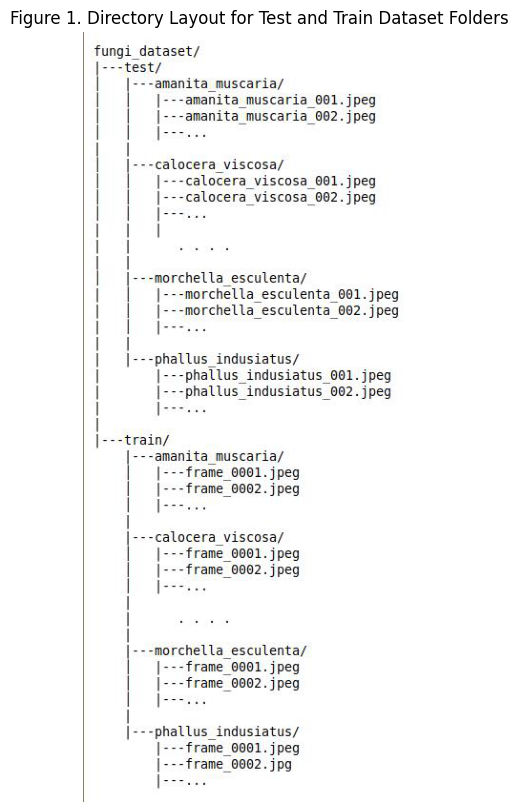

In [10]:
# Load image using PIL
image_pil = Image.open(os.path.join(location_of_this_ipynb_file, 'Pics/fungi_dataset_directory_map.jpeg'))
# Convert PIL image to NumPy array
image_np = np.array(image_pil)
# Display image
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.title("Figure 1. Directory Layout for Test and Train Dataset Folders ");
plt.imshow(image_np);

**Full Directory Contents:** (including fungi_dataset folder)<br> 
This Jupyter Notebook file:<br>
-- PyTorch_Mushroom_Image_Classification.ipynb<br>
Image folders:<br>
-- fungi_dataset folder (holding the train and test data set folders) <br>
-- Pics folder (holding the images used in the ipynb file)<br>
Video files (nine .mp4 video montage clips from which training data set images will be extracted):<br>
-- amanita_muscaria.mp4<br>
-- calocera_viscosa.mp4<br>
-- clathrus_ruber.mp4<br>
-- coprinus_comatus.mp4<br>
-- favolaschia_calocera.mp4<br>
-- ganoderma_lucidum.mp4<br>
-- laetiporus_sulphureus.mp4<br>

All work was done on a linux Ubuntu 22.04.3 LTS operating system.<br><br>
The project began with a search of YouTube for videos of each mushroom species. Once several suitable videos were located, an open source, linux based video screen capture tool, SimpleScreenRecorder version 0.3.11 (shown below in Figures 1 and 2), was used to capture the relevant sections of each video. The  SimpleScreenRecorder software allows for selection of specific sections of the screen and output file format (here, .mp4 format was used).<br><br>

The next step was selecting approximately 10 to 12 highly relevant one second sections from each of the videos screen recorded for each species. These one second clips were then merged into .mp4 files that would later provide the frames used as training set image data. This was done using an open source, linux based video editing tool,  Kdenlive version 21.12.3 (shown below in Figure 3). This led to the .mp4 videos listed in Table 1.

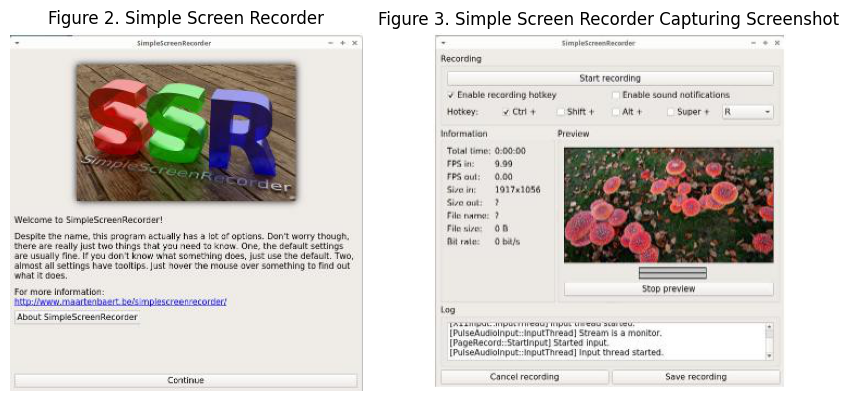

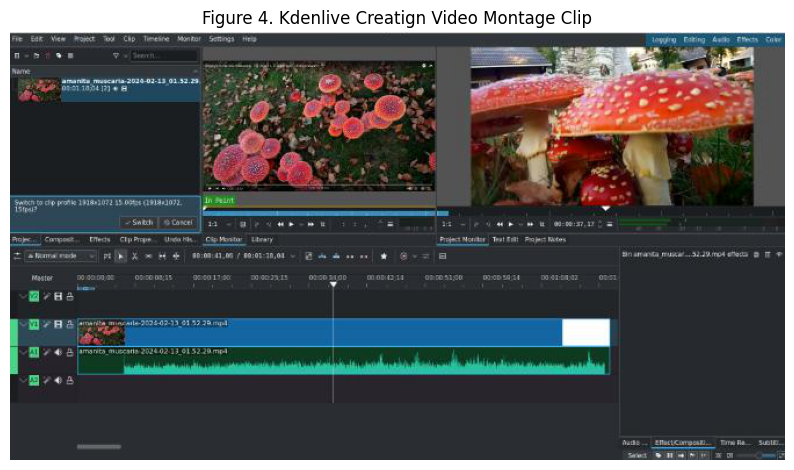

In [11]:
plt.figure(figsize=(10, 10))
image_pil_1 = Image.open(os.path.join(location_of_this_ipynb_file, 'Pics/simple_screen_recorder.jpeg'))
image_1 = np.array(image_pil_1)
image_pil_2 = Image.open(os.path.join(location_of_this_ipynb_file, 'Pics/simple_screen_recorder2.jpeg'))
image_2 = np.array(image_pil_2)
plt.subplot(1, 2, 1);
plt.imshow(image_1);
plt.title("Figure 2. Simple Screen Recorder");
plt.axis('off');
plt.subplot(1, 2, 2);
plt.imshow(image_2);
plt.title("Figure 3. Simple Screen Recorder Capturing Screenshot");
plt.axis('off');

plt.figure(figsize=(10, 10))
image_pil_3 = Image.open(os.path.join(location_of_this_ipynb_file, 'Pics/kdenlive.jpeg'))
image_3 = np.array(image_pil_3)
plt.imshow(image_3);
plt.title("Figure 4. Kdenlive Creatign Video Montage Clip");
plt.axis('off');

The function "video_frame_extract_to_train()" is sent a montaged video file and the destination folder to hold the extracted frames from the video. The "video_frame_extract_to_train()" function also calls the "image_transformer()" function to provide image transformations. Frames extracted from each montage video are transformed by the "image_transformer()" function in groups of six as shown below before being saved into their corresponding training set folder under directory fungi_dataset/train/.

Transforms performed by "image_transformer()" function in groups of six:<br>
First frame of six frame group      =>    transform = resize image<br>
Second frame of six frame group     =>    transform = resize image, rotate = + 30 deg<br>
Third frame of six frame group      =>    transform = resize image, rotate = - 30 deg<br>
Fourth frame of six frame group     =>    transform = resize image, flip horizontally<br>
Fifth frame of six frame group      =>    transform = resize image, flip horizontally, rotate = + 30 deg<br>
Sixth frame of six frame group      =>    transform = resize image, flip horizontally, rotate = - 30 deg<br>

The frames extracted from each montaged video clip through the combined work of the "video_frame_extract_to_train()" and "image_transformer()" functions is summarized in the Table 1 below

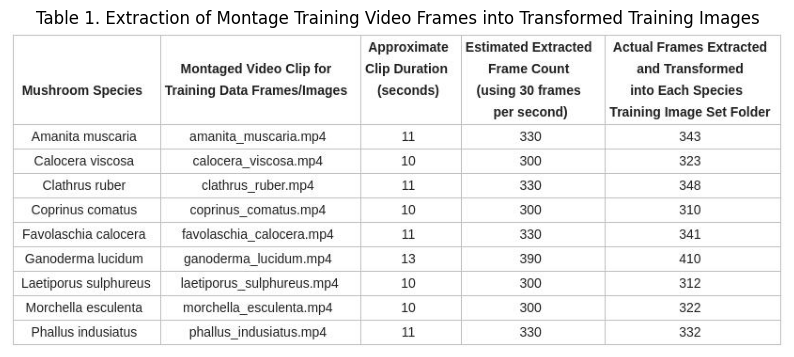

In [12]:
plt.figure(figsize=(10, 10))
image_pil = Image.open(os.path.join(location_of_this_ipynb_file, 'Pics/montage_videos_table.jpeg'))
image = np.array(image_pil)
plt.imshow(image);
plt.title("Table 1. Extraction of Montage Training Video Frames into Transformed Training Images");
plt.axis('off');

In [13]:
# Function to transform frames in waves or groups of six
def image_transformer(input_image, six_counter):
    # Perform various image transforms depending on value of six_counter
    #    then return transformed image
    resized_image = cv2.resize(input_image, (300, 300))
    resized_flipped_image = cv2.flip(resized_image, 1)
    
    if six_counter == 1: # transform = resize image
        return resized_image
    
    if six_counter == 2: # transform = resize image, rotate = + 30 deg
        rotation_matrix = cv2.getRotationMatrix2D((300 / 2, 300 / 2), 30, 1)
        resized_pos30image = cv2.warpAffine(resized_image, rotation_matrix, (300, 300))
        return resized_pos30image
    
    if six_counter == 3: # transform = resize image, rotate = - 30 deg
        rotation_matrix = cv2.getRotationMatrix2D((300 / 2, 300 / 2), -30, 1)
        resized_neg30image = cv2.warpAffine(resized_image, rotation_matrix, (300, 300))
        return resized_neg30image
    
    if six_counter == 4: # transform = resize image, flip horizontally    
        return resized_flipped_image  
    
    if six_counter == 5: # transform = resize image, flip horizontally, rotate = + 30 deg
        rotation_matrix = cv2.getRotationMatrix2D((300 / 2, 300 / 2), 30, 1)
        resized_flipped_pos30image = cv2.warpAffine(resized_flipped_image, rotation_matrix, (300, 300))
        return resized_flipped_pos30image
    
    if six_counter == 6: # transform = resize image, flip horizontally, rotate = - 30 deg
        rotation_matrix = cv2.getRotationMatrix2D((300 / 2, 300 / 2), -30, 1)
        resized_flipped_neg30image = cv2.warpAffine(resized_flipped_image, rotation_matrix, (300, 300)) 
        return resized_flipped_neg30image

# Function to:
# --- 1.) Read each frame
# --- 2.) Send each frame for transformation
# --- 3.) Save each transformed frame as a JPEG image into 'training_folder_path'
def video_frame_extract_to_train (video_file_path, training_folder_path):
    # Create the output folder if it doesn't exist
    os.makedirs(training_folder_path, exist_ok=True)
    
    six_counter = 1;
    # Create a video_reader object
    cap = cv2.VideoCapture(video_file_path)
    
    # Get information about the video
    fps = cap.get(cv2.CAP_PROP_FPS)
    num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
      
    # --- 1.) Read each frame
    # --- 2.) Send frame for transformation
    # --- 3.) Save each current frame as a JPEG image into 'training_folder_path'
    # Loop through each frame
    for frame_index in range(num_frames):
        # --- 1.) Read each frame
        # Define video capture object
        ret, current_frame = cap.read()
        if not ret:
            break

        # --- 2.) Send frame for transformation with six_counter to determine
        #   type of transformation
        transformed_frame = image_transformer(current_frame, six_counter)

        
        # --- 3.) Save each transformed frame as a JPEG image into appropriate training folder
        num_id = str(frame_index + 1).zfill(3)
        file_type = '.jpeg' 
        cv2.imwrite(os.path.join( training_folder_path + "frame_" + num_id + file_type ), transformed_frame)
        
        # update six_counter variable for next round
        six_counter = six_counter + 1;
        # reset six_counter variable after every 6 image transformations
        if six_counter > 6:
            six_counter = 1
    
    # Release the video capture object
    cap.release()
 


In [83]:
# List of montage videos 
montage_video_list =['amanita_muscaria.mp4','calocera_viscosa.mp4','clathrus_ruber.mp4',
                     'coprinus_comatus.mp4','favolaschia_calocera.mp4','ganoderma_lucidum.mp4',
                     'laetiporus_sulphureus.mp4','morchella_esculenta.mp4','phallus_indusiatus.mp4']
# List of training folders
training_folder_list=['fungi_dataset/train/amanita_muscaria/','fungi_dataset/train/calocera_viscosa/',
                      'fungi_dataset/train/clathrus_ruber/','fungi_dataset/train/coprinus_comatus/',
                      'fungi_dataset/train/favolaschia_calocera/','fungi_dataset/train/ganoderma_lucidum/',   
                      'fungi_dataset/train/laetiporus_sulphureus/','fungi_dataset/train/morchella_esculenta/',
                      'fungi_dataset/train/phallus_indusiatus/']
# Use both lists and functions to construct training image data sets
for video, folder in zip(montage_video_list, training_folder_list):
    video_path = os.path.join(location_of_this_ipynb_file, video)
    folder_path = os.path.join(location_of_this_ipynb_file, folder)
    video_frame_extract_to_train(video_path, folder_path);

The training image set folders now contain the numbers of images shown in the rightmost column of Table 1. 

In [192]:
# Function to display image samples of test and train sets for each mushroom species 
def display_random_image_sets(folder_species, folder_everyday_name, num_images=4):
    print('======================================================================================================')
    print('======================================================================================================')
    folder_path = os.path.join(location_of_this_ipynb_file, 
                                                    'fungi_dataset/test/'+str(folder_species)+'/')
    # Get a list of all image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('jpeg'))]

    # Randomly select num_images from the list
    selected_images = random.sample(image_files, num_images)

    # Display the selected images
    fig, axes = plt.subplots(1, num_images, figsize=(12, 3))
    
    print('TEST SET SAMPLE IMAGES FOR ', str(folder_species), '\t', str(folder_everyday_name))

    for i, image_file in enumerate(selected_images):
        image_path = os.path.join(folder_path, image_file)
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
    
    plt.show()
        
    folder_path = os.path.join(location_of_this_ipynb_file, 
                                                    'fungi_dataset/train/'+str(folder_species)+'/')
    # Get a list of all image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('jpeg'))]

    # Randomly select num_images from the list
    selected_images = random.sample(image_files, num_images)

    # Display the selected images
    fig, axes = plt.subplots(1, num_images, figsize=(12, 3))
    
    print('TRAIN SET SAMPLE IMAGES FOR ', str(folder_species), '\t', str(folder_everyday_name))

    for i, image_file in enumerate(selected_images):
        image_path = os.path.join(folder_path, image_file)
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')

    plt.show()

TEST SET SAMPLE IMAGES FOR  amanita_muscaria 	 Common Name: "Fly Agaric Mushroom"


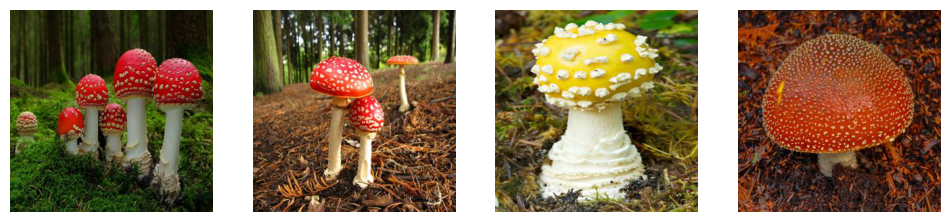

TRAIN SET SAMPLE IMAGES FOR  amanita_muscaria 	 Common Name: "Fly Agaric Mushroom"


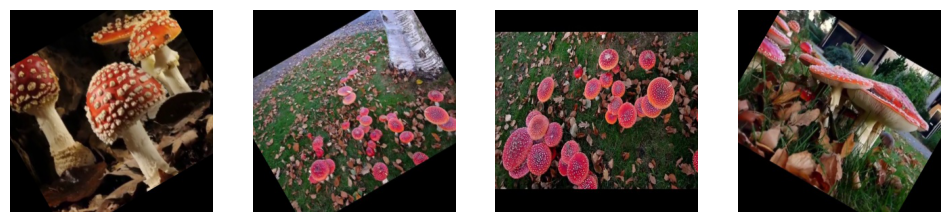

TEST SET SAMPLE IMAGES FOR  calocera_viscosa 	 Common Name: "Yellow Staghorn Mushroom"


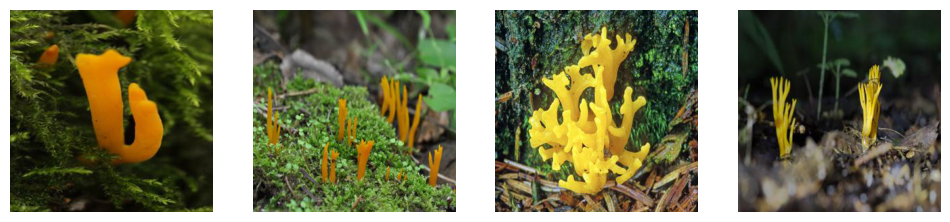

TRAIN SET SAMPLE IMAGES FOR  calocera_viscosa 	 Common Name: "Yellow Staghorn Mushroom"


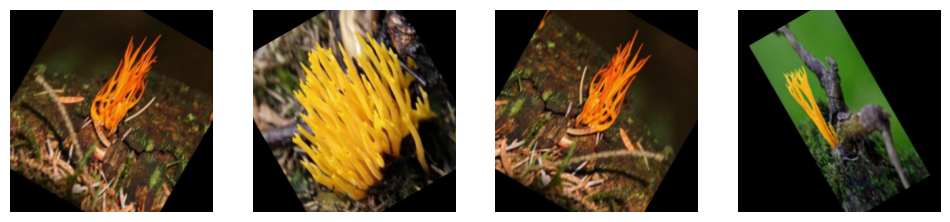

TEST SET SAMPLE IMAGES FOR  clathrus_ruber 	 Common Name: "Red Cage Lattice Stinkhorn"


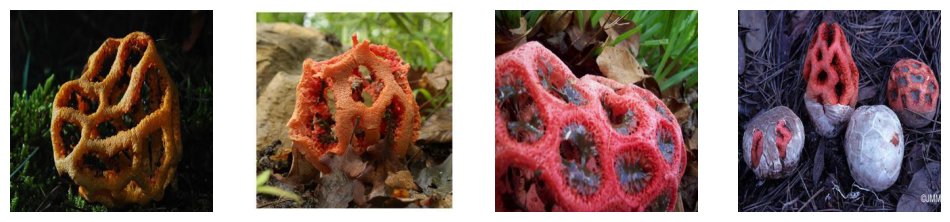

TRAIN SET SAMPLE IMAGES FOR  clathrus_ruber 	 Common Name: "Red Cage Lattice Stinkhorn"


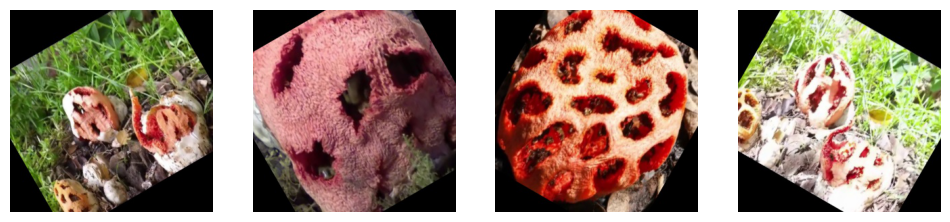

TEST SET SAMPLE IMAGES FOR  coprinus_comatus 	 Common Name: "Shaggy Ink Cap Mushroom"


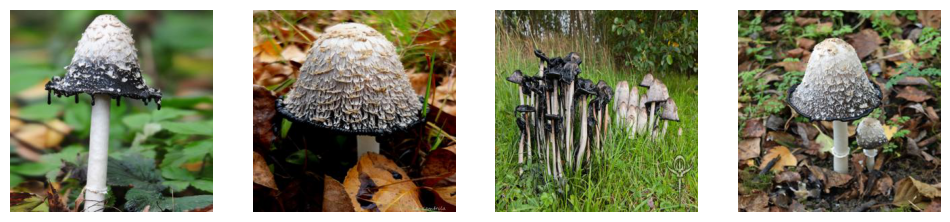

TRAIN SET SAMPLE IMAGES FOR  coprinus_comatus 	 Common Name: "Shaggy Ink Cap Mushroom"


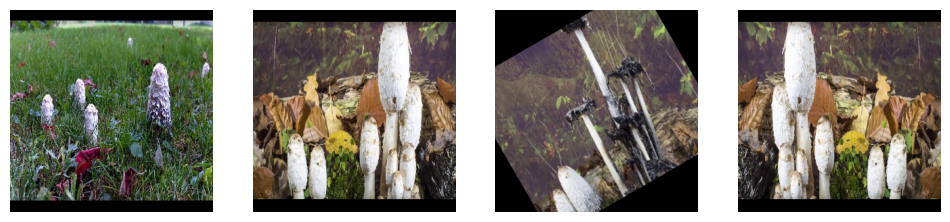

TEST SET SAMPLE IMAGES FOR  favolaschia_calocera 	 Common Name: "Orange Pore Fungus"


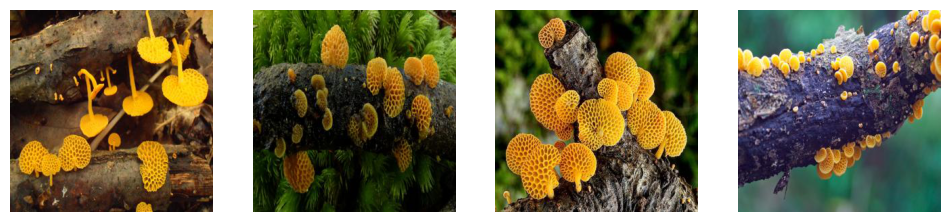

TRAIN SET SAMPLE IMAGES FOR  favolaschia_calocera 	 Common Name: "Orange Pore Fungus"


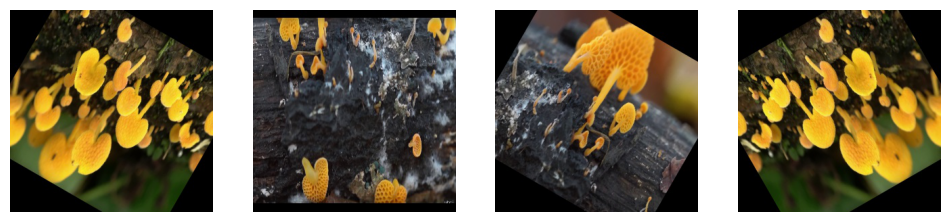

TEST SET SAMPLE IMAGES FOR  ganoderma_lucidum 	 Common Name: "Reishi Garnished Conk Mushroom"


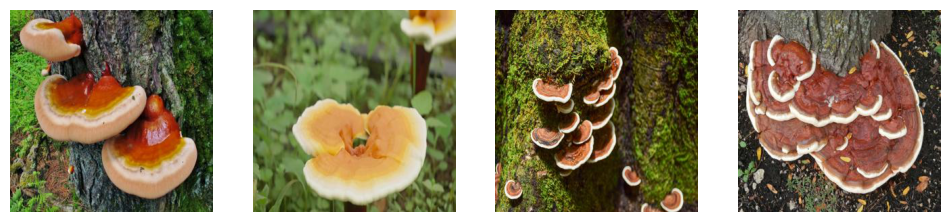

TRAIN SET SAMPLE IMAGES FOR  ganoderma_lucidum 	 Common Name: "Reishi Garnished Conk Mushroom"


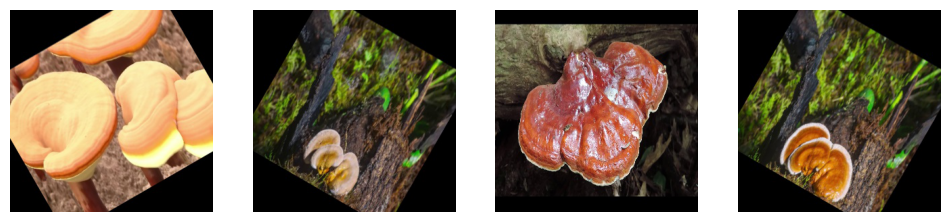

TEST SET SAMPLE IMAGES FOR  laetiporus_sulphureus 	 Common Name: "Chicken of The Woods Mushroom"


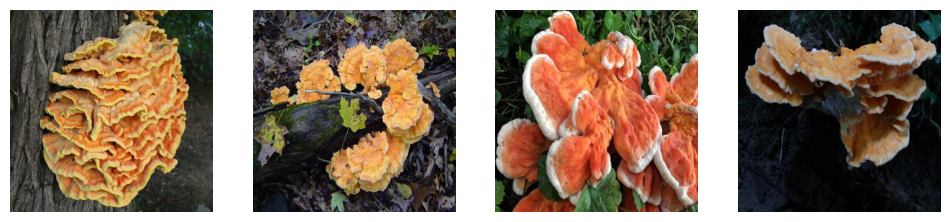

TRAIN SET SAMPLE IMAGES FOR  laetiporus_sulphureus 	 Common Name: "Chicken of The Woods Mushroom"


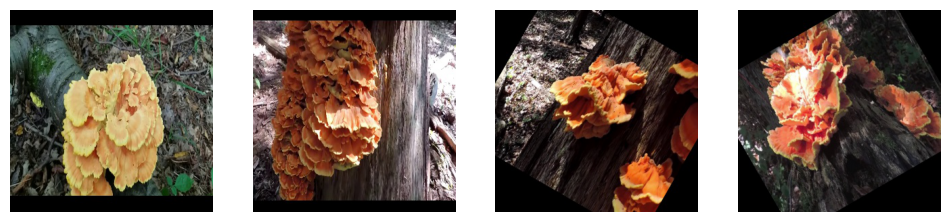

TEST SET SAMPLE IMAGES FOR  morchella_esculenta 	 Common Name: "Morel Mushroom"


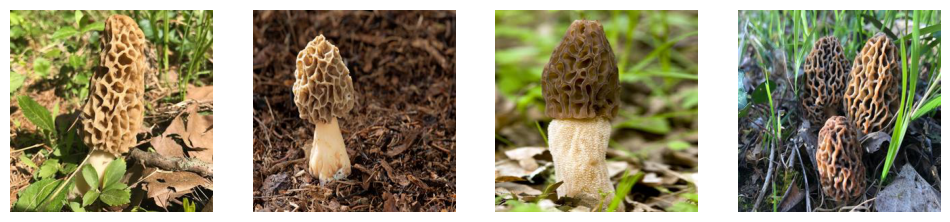

TRAIN SET SAMPLE IMAGES FOR  morchella_esculenta 	 Common Name: "Morel Mushroom"


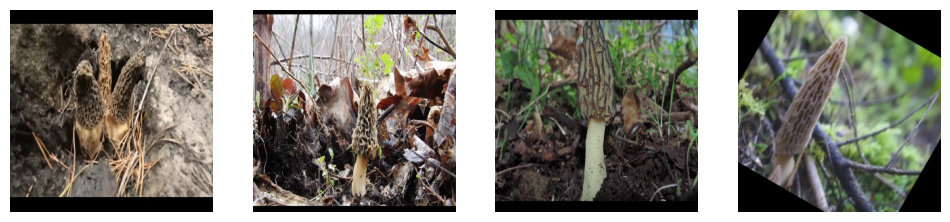

TEST SET SAMPLE IMAGES FOR  phallus_indusiatus 	 Common Name: "Bridal Veil Stinkhorn Mushroom"


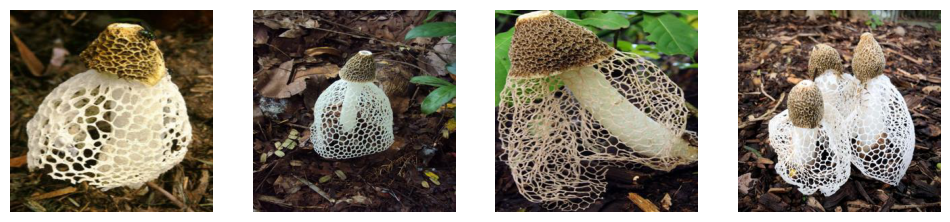

TRAIN SET SAMPLE IMAGES FOR  phallus_indusiatus 	 Common Name: "Bridal Veil Stinkhorn Mushroom"


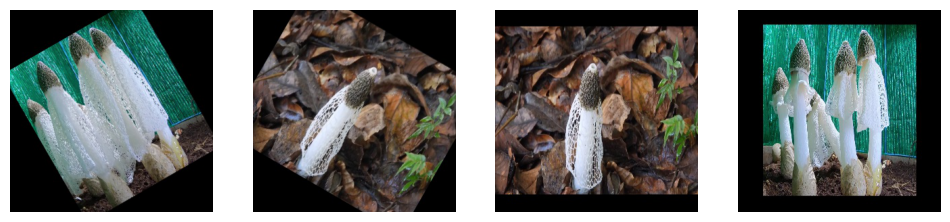

In [193]:
species_names = ['amanita_muscaria',
               'calocera_viscosa', 
               'clathrus_ruber', 
               'coprinus_comatus', 
               'favolaschia_calocera',
               'ganoderma_lucidum', 
               'laetiporus_sulphureus',
               'morchella_esculenta', 
               'phallus_indusiatus']

common_names = ['Common Name: "Fly Agaric Mushroom"', 
          'Common Name: "Yellow Staghorn Mushroom"', 
          'Common Name: "Red Cage Lattice Stinkhorn"', 
          'Common Name: "Shaggy Ink Cap Mushroom"',
          'Common Name: "Orange Pore Fungus"', 
          'Common Name: "Reishi Garnished Conk Mushroom"', 
          'Common Name: "Chicken of The Woods Mushroom"',         
          'Common Name: "Morel Mushroom"', 
          'Common Name: "Bridal Veil Stinkhorn Mushroom"'         
         ]
for species, everyday_name in zip(species_names, common_names):
    display_random_image_sets(species, everyday_name)

In [36]:
# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [37]:
# Define your dataset paths for training and testing
train_data_path = os.path.join(location_of_this_ipynb_file, 'fungi_dataset/train/')
test_data_path = os.path.join(location_of_this_ipynb_file, 'fungi_dataset/test/')

In [38]:
# Define data transformations
data_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [39]:
# Load datasets
train_dataset = datasets.ImageFolder(train_data_path, transform=data_transform)
test_dataset = datasets.ImageFolder(test_data_path, transform=data_transform)

In [40]:
# Define dataloaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [42]:
# Define the ResNet50 model
model = models.resnet50(pretrained=True);
# Replace the final fully connected layer for mushroom classification task
num_ftrs = model.fc.in_features;
model.fc = nn.Linear(num_ftrs, len(class_names));
model.to(device);

In [43]:
# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [48]:
# Function to train the model
def train_model(model, criterion, optimizer, num_epochs=10):
    loss_list = []
    accuracy_list = []
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        corrects = 0
        base_text = '.'
        # Record start time
        start_time = time.time()    

        for inputs, labels in dataloaders['train']:
            print(base_text, end='')
            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, preds = torch.max(outputs, 1)
            corrects += torch.sum(preds == labels.data)
                
        # Record end time
        end_time = time.time()
        # Calculate elapsed time
        elapsed_time = end_time - start_time

        epoch_loss = running_loss / dataset_sizes['train']
        epoch_acc = corrects.double() / dataset_sizes['train']

        print(f'\nEpoch {epoch + 1}/{num_epochs}'
              f' Loss: {epoch_loss:.4f}'
              f' Acc: {epoch_acc:.4f}'
              f' Epoch Duration: {elapsed_time:.0f} seconds')
        loss_list.append(epoch_loss)
        accuracy_list.append(epoch_acc)
        
    return model, loss_list, accuracy_list

In [49]:
# Train the model
trained_model, loss_list, accuracy_list = train_model(model, criterion, optimizer, num_epochs=10)
# silence warnings
import warnings
warnings.filterwarnings('ignore')

................................................................................................
Epoch 1/10 Loss: 0.7436 Acc: 0.8454 Epoch Duration: 1834.5162143707275 seconds
................................................................................................
Epoch 2/10 Loss: 0.0963 Acc: 0.9813 Epoch Duration: 2089.622031211853 seconds
................................................................................................
Epoch 3/10 Loss: 0.0667 Acc: 0.9859 Epoch Duration: 2043.472440481186 seconds
................................................................................................
Epoch 4/10 Loss: 0.0534 Acc: 0.9872 Epoch Duration: 2234.8858783245087 seconds
................................................................................................
Epoch 5/10 Loss: 0.0374 Acc: 0.9918 Epoch Duration: 1981.3628253936768 seconds
................................................................................................
Epoch 6/10 Loss: 0.0282 A

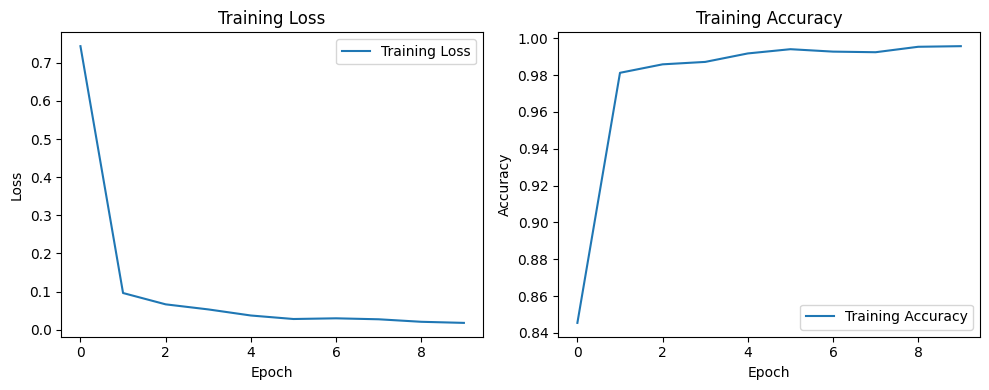

In [50]:
# Plot the training set loss
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(loss_list, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()


# Plot the training set accuracy
plt.subplot(1, 2, 2)
plt.plot(accuracy_list, label='Training Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training Accuracy')
plt.legend()

plt.tight_layout();
plt.show();

In [144]:
class_names = ['amanita_muscaria',
               'calocera_viscosa', 
               'clathrus_ruber', 
               'coprinus_comatus', 
               'favolaschia_calocera',
               'ganoderma_lucidum', 
               'laetiporus_sulphureus',
               'morchella_esculenta', 
               'phallus_indusiatus']

# Function to evaluate the model on the test set
def evaluate_model(model):
    model.eval()
    running_loss = 0.0
    corrects = 0
    all_labels = []
    all_preds = []
    image_paths = []
    misclassified_image_paths = []
    misclassified_images = []

    with torch.no_grad():
        for inputs, labels in dataloaders['test']:
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            running_loss += loss.item() * inputs.size(0)

            _, preds = torch.max(outputs, 1)
            corrects += torch.sum(preds == labels.data)

            all_labels.extend(labels.numpy())
            all_preds.extend(preds.numpy())
            
            # Iterate over each image in the batch
            for i in range(inputs.size(0)):
                # Get the true and predicted labels for the current image
                true_label_index = labels[i].item()
                predicted_label_index = preds[i].item()

                # Collect misclassified images as tensors from inputs[i]
                if true_label_index != predicted_label_index:
                    misclassified_images.append(inputs[i])
                    # Plot the image and show index
                    # print('Index:', i)
                    # plt.imshow(inputs[i].permute(1, 2, 0).numpy());
                    # plt.title(f'True: {class_names[true_label_index]} \nPredicted: {class_names[predicted_label_index]}')
                    # plt.show()

            
            
    test_loss = running_loss / dataset_sizes['test']
    test_acc = corrects.double() / dataset_sizes['test']

    print(f'Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')

    return all_labels, all_preds, misclassified_images

In [145]:
# Evaluate the model
true_labels, predicted_labels, mislabeled_images = evaluate_model(trained_model)

Test Loss: 0.3864, Test Acc: 0.8756


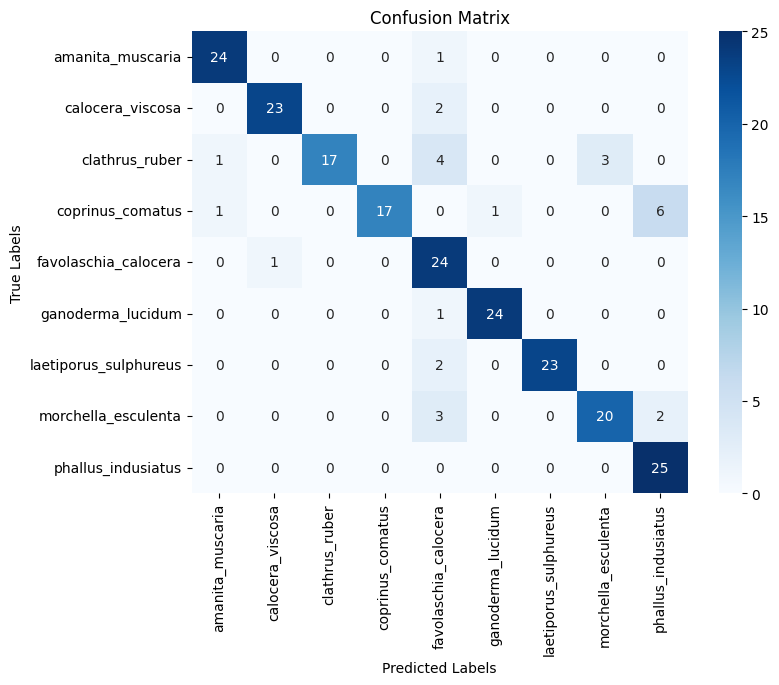

          Predictions  Errors Accuracy
Model                                 
ResNet50          225      28  87.56 %


In [196]:
# Function to plot confusion matrix
def plot_confusion_matrix(true_labels, predicted_labels, class_names):
    cm = confusion_matrix(true_labels, predicted_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.show()

# Plot confusion matrix
plot_confusion_matrix(true_labels, predicted_labels, class_names)

accuracy = str(round((1- (len(mislabeled_images)/len(predicted_labels)))*100, 2)) + ' %'

# Organize Data
data = {'Model': ['ResNet50'],
        'Predictions': [len(predicted_labels)],
        'Errors': [len(mislabeled_images)],
        'Accuracy': [accuracy]}
# Construct a DataFrame
df = pd.DataFrame.from_dict(data).set_index('Model')
# Display the DataFrame
print(df);

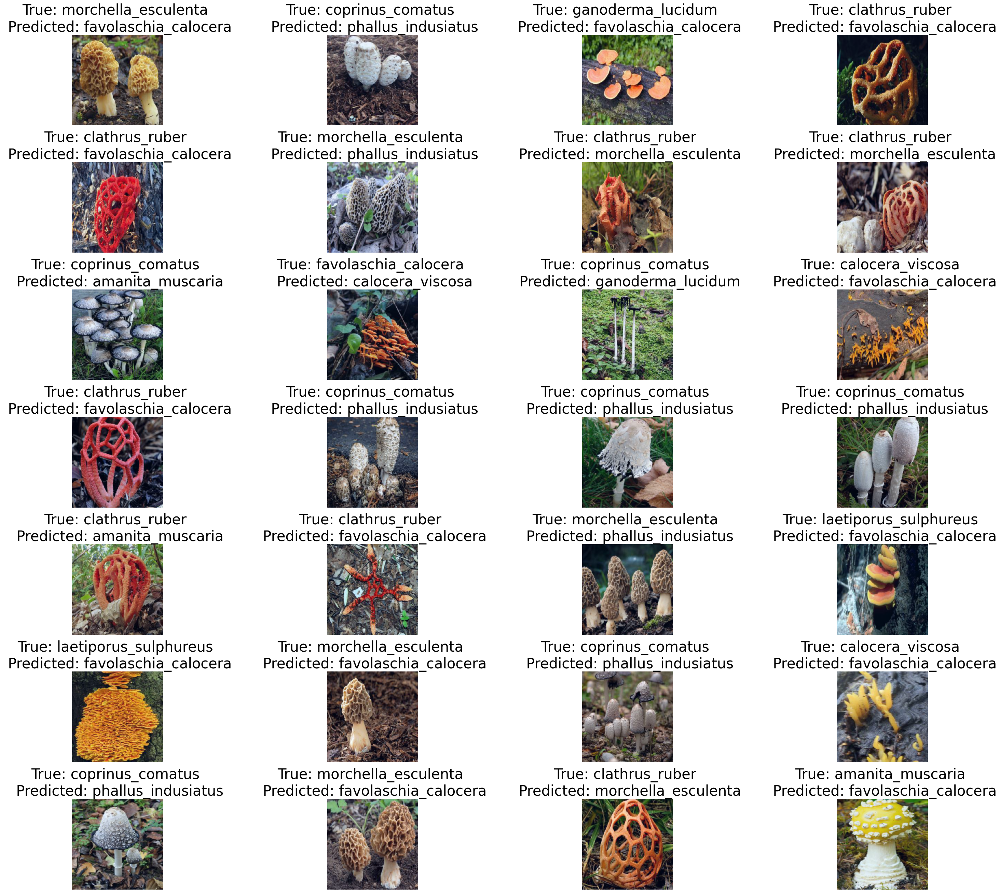

In [202]:
# Display all mislabeled images with class names for model with best performance ("General Model CFV")
mislabeled_indices = np.where(np.array(true_labels) != np.array(predicted_labels))[0];

plt.figure(figsize=(30,30))   
for i in range(0, len(mislabeled_indices)):
    index = mislabeled_indices[i]
    true_label_index = true_labels[index]
    predicted_label_index = predicted_labels[index]

    image_np = mislabeled_images[i].permute(1, 2, 0).numpy()
    image_np = (image_np - image_np.min()) / (image_np.max() - image_np.min())
    image_pil = Image.fromarray((image_np * 255).astype('uint8'))

    plt.subplot(8, 4, i + 1)
    plt.imshow(image_pil)
    plt.title(f'True: {class_names[true_label_index]} \n'
              f' Predicted: {class_names[predicted_label_index]}', fontsize=30)
    plt.axis('off')
plt.tight_layout()
plt.show();

OBSERVATIONS:

The model had the most difficulty with:<br>
&nbsp; &nbsp; 1.) Clathrus ruber  (Red Cage Lattice Stinkhorn Mushroom)<br>
&nbsp; &nbsp; 2.) Coprinus comatus (Shaggy Ink Cap Mushroom)<br>
&nbsp; &nbsp; 3.) Morchella esculenta (Morel Mushroom)<br><br>

Clathrus ruber was commonly mistaken for Favolaschia calocera (Yellow Staghorn Mushroom) with 4 errors and 
Morchella esculenta (Morel Mushroom) with 3 errors. All three species share a fenestrated, spindly appearance on some sections of their structures.<br><br> 

Difficulties classifying Coprinus comatus are to be expected. The video used to provide training data images, "coprinus_comatus.mp4", shows the dramatic changes in appearance the species undergoes during growth. This may make Coprinus comatus at times appear like another species. In this case, the model misclassified it as Phallus indusiatus (Bridal Veil Stinkhorn Mushroom) in 6 cases. This seems reasonable since both species share an elongated, torpedo-like shape.<br><br>

The wrinkled cap of Morchella esculenta may have been a factor in its misclassification as Favolaschia calocera 3 times and Phallus indusiatus in 2 cases.<br><br> 
 

THE NINE MUSHROOM SPECIES:



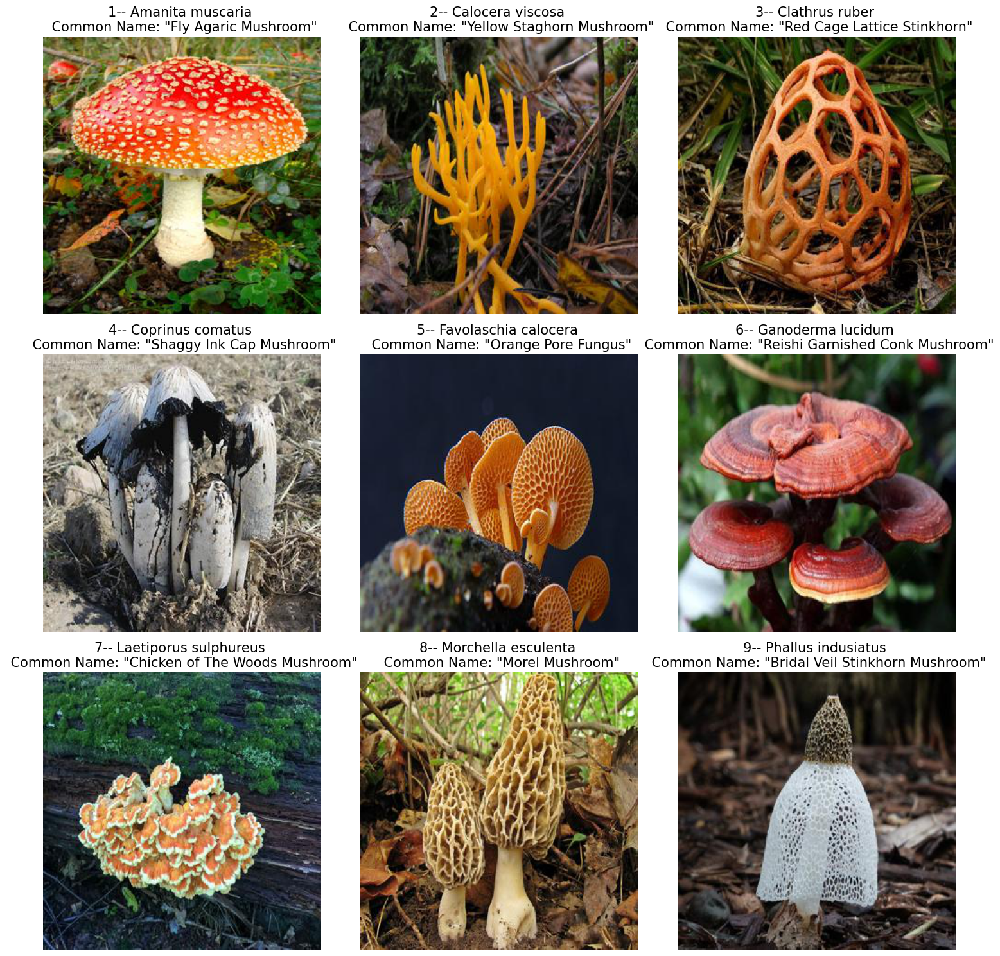

In [206]:
# Show the plot
print('THE NINE MUSHROOM SPECIES:\n')
# Create a figure and axes
plt.figure(figsize=(15, 15))

for i in range(0, num_images):

    plt.subplot(3, 3, i + 1)
    # Load image using PIL
    image_pil = Image.open(image_paths[i])
    # Convert PIL image to NumPy array
    image_np = np.array(image_pil)
    # Display image
    plt.imshow(image_np)
    plt.title(f'{labels[i]}', fontsize=15)
    plt.axis('off')
plt.tight_layout()
plt.show();